## Community detection

### Imports

In [3]:
from graph_loader import get_graph, save_graph, generate_graph
from networkx.algorithms.community import louvain_communities, girvan_newman
from networkx.algorithms.community.quality import modularity
from shapely.geometry import LineString
from collections import Counter
import matplotlib.pyplot as plt
import networkx as nx
import osmnx as ox
import pandas as pd
import random
import folium

In [4]:
G = get_graph("Wrocław, Poland", "wroclaw.graphml")

Loading graph from graphs/wroclaw.graphml


In [5]:
type(G)

networkx.classes.multidigraph.MultiDiGraph

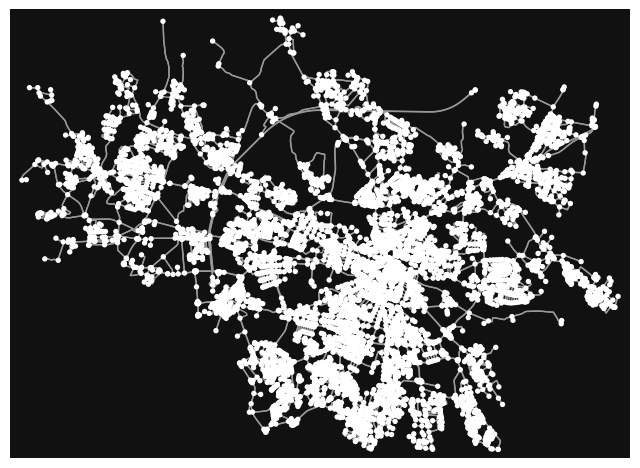

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [6]:
ox.plot_graph(G)

In [7]:
ox.plot_graph_folium(G, popup_attribute='name', weight=2, color='blue')

In [12]:
# Load the graph (either from a file or downloaded)
G = ox.graph_from_place('Wrocław, Poland', network_type='drive')

# Create the map centered on Wrocław
m = ox.plot_graph_folium(G, popup_attribute='name', weight=2, color='blue')

# Let's find a path between two nodes (for example)
orig_node = list(G.nodes())[0]  # Replace with your specific origin node
dest_node = list(G.nodes())[-1]  # Replace with your specific destination node

# Find the shortest path (or any path algorithm)
route = nx.shortest_path(G, orig_node, dest_node, weight='length')

# Highlight the path with a different color (e.g., red)
for i in range(len(route) - 1):
    u, v = route[i], route[i + 1]
    edge_data = G.get_edge_data(u, v)
    # Ensure the edge has a geometry
    if 'geometry' in edge_data[0]:
        geometry = edge_data[0]['geometry']
        # Plot the path on the map with red color
        points = [(lat, lon) for lon, lat in geometry.coords]
        folium.PolyLine(points, color='red', weight=5, opacity=0.7).add_to(m)

# Display the map
m.save('highlighted_path_map.html')

In [13]:
stats = ox.basic_stats(G)
df_stats = pd.DataFrame(stats.items(), columns=["Metryka", "Wartość"])
df_stats

,Metryka,Wartość
0,n,7272
1,m,17174
2,k_avg,4.723322
3,edge_length_total,2435342.303
4,edge_length_avg,141.804024
5,streets_per_node_avg,2.771727
6,streets_per_node_counts,"{0: 0, 1: 1264, 2: 141, 3: 4901, 4: 927, 5: 35..."
7,streets_per_node_proportions,"{0: 0.0, 1: 0.17381738173817382, 2: 0.01938943..."
8,intersection_count,6008
9,street_length_total,1400209.589


### Węzły z najwyższym stopniem

In [14]:
degree_dict = dict(G.degree())
top_nodes = sorted(degree_dict.items(), key=lambda x: x[1], reverse=True)[:10]

for node, degree in top_nodes:
    print(f"Węzeł {node} ma stopień: {degree}")

Węzeł 252954814 ma stopień: 10
Węzeł 167074929 ma stopień: 9
Węzeł 252108257 ma stopień: 9
Węzeł 145728087 ma stopień: 8
Węzeł 145728119 ma stopień: 8
Węzeł 145728120 ma stopień: 8
Węzeł 151024797 ma stopień: 8
Węzeł 158719875 ma stopień: 8
Węzeł 159986453 ma stopień: 8
Węzeł 167105519 ma stopień: 8


### Najdłuższe krawędzie

In [15]:
edges = ox.utils_graph.graph_to_gdfs(G, nodes=False)
edges_sorted = edges.sort_values(by='length', ascending=False).head(10)

edges_sorted[['name', 'length']]

,,,name,length
u,v,key,,
3918627706,1291612570,0,"[most Rędziński, Autostradowa Obwodnica Wrocła...",7485.842
1273299424,1366021447,0,"[most Rędziński, Autostradowa Obwodnica Wrocła...",7451.269
2772134294,2920954439,0,"[Autostradowa Obwodnica Wrocławia, Trasa Bohat...",4792.988
2920888489,1362765211,0,"[Autostradowa Obwodnica Wrocławia, Trasa Bohat...",4549.836
3069392833,1980042113,0,"[Janowska, most Brodzki]",2903.791
1980042113,3069392833,0,"[Janowska, most Brodzki]",2903.791
1273299447,1366035583,0,Autostradowa Obwodnica Wrocławia,2677.326
2196511210,566472207,0,Autostradowa Obwodnica Wrocławia,2605.750
5312084891,3138134848,0,aleja Prezydenta Ryszarda Kaczorowskiego,2564.272


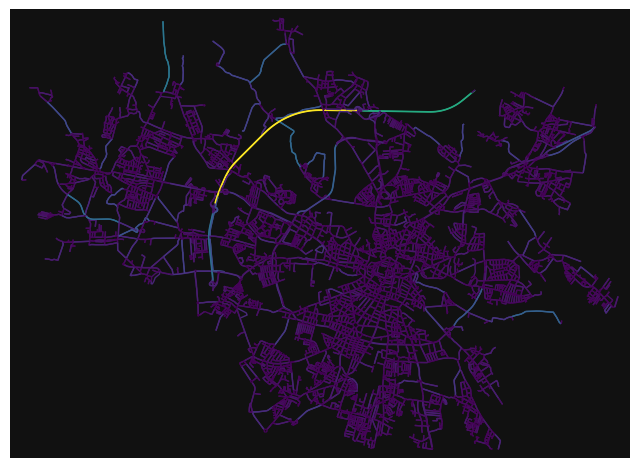

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [16]:
ec = ox.plot.get_edge_colors_by_attr(G, attr='length', cmap='viridis')

ox.plot_graph(G, edge_color=ec, edge_linewidth=1, node_size=0)

# Community detection

## Modularity based community detection using Louvain algorithm

### Podzbiór dla centrum

In [8]:
# 2 km wokół Rynku
center = ox.geocode('Wrocław, Rynek')
G_sub = ox.graph_from_point(center, dist=2000, network_type='drive')

In [11]:
# Lista zbiorów → słownik node: community_id
partition = louvain_communities(G_sub, seed=42)
mod = modularity(G_sub, partition)
print(f"Modularność Louvain: {mod:.3f}")

Modularność Louvain: 0.884


### Mapa wersja nr 1

In [10]:
def random_color():
    return "#"+''.join([random.choice('89ABCDEF') for _ in range(6)])

comm_colors = [random_color() for _ in range(len(partition))]
node_to_comm = {}
for idx, comm in enumerate(partition):
    for node in comm:
        node_to_comm[node] = idx

# Centruj mapę na środku podgrafu
lat = list(nx.get_node_attributes(G_sub, 'y').values())
lon = list(nx.get_node_attributes(G_sub, 'x').values())
center_lat, center_lon = sum(lat)/len(lat), sum(lon)/len(lon)

m = folium.Map(location=[center_lat, center_lon], zoom_start=13)

for node in G_sub.nodes():
    folium.CircleMarker(
        location=[G_sub.nodes[node]['y'], G_sub.nodes[node]['x']],
        radius=3,
        color=comm_colors[node_to_comm[node]],
        fill=True,
        fill_opacity=0.8,
        popup=f'Węzeł: {node} | Społeczność: {node_to_comm[node]}'
    ).add_to(m)

m.save('community_plots/community_map_wroclaw.html')
print("Mapa zapisana jako 'community_map_wroclaw.html'")


Mapa zapisana jako 'community_map_wroclaw.html'


In [12]:
### Mapa wersja nr 2

In [13]:
# 1. Wygeneruj kolory dla każdej społeczności
def random_color():
    return "#"+''.join([random.choice('0123456789ABCDEF') for _ in range(6)])

colors = [random_color() for _ in range(len(partition))]

# 2. Przypisz każdemu węzłowi indeks społeczności
node_to_comm = {}
for idx, comm in enumerate(partition):
    for node in comm:
        node_to_comm[node] = idx

# 3. Oblicz środek mapy
lat = list(nx.get_node_attributes(G_sub, 'y').values())
lon = list(nx.get_node_attributes(G_sub, 'x').values())
center_lat = sum(lat) / len(lat)
center_lon = sum(lon) / len(lon)

# 4. Tworzenie mapy
m = folium.Map(location=[center_lat, center_lon], zoom_start=14, tiles="cartodbpositron")

# 5. Dodaj węzły do mapy, pokolorowane wg społeczności
for node in G_sub.nodes():
    comm = node_to_comm[node]
    folium.CircleMarker(
        location=[G_sub.nodes[node]['y'], G_sub.nodes[node]['x']],
        radius=3,
        color=colors[comm],
        fill=True,
        fill_color=colors[comm],
        fill_opacity=0.9,
        popup=f'Społeczność: {comm}'
    ).add_to(m)

# 6. (Opcjonalnie) Dodaj krawędzie jako linie
for u, v, data in G_sub.edges(data=True):
    if 'geometry' in data:
        line = [(lat, lon) for lon, lat in data['geometry'].coords]
    else:
        line = [
            (G_sub.nodes[u]['y'], G_sub.nodes[u]['x']),
            (G_sub.nodes[v]['y'], G_sub.nodes[v]['x'])
        ]
    folium.PolyLine(line, color="#cccccc", weight=1, opacity=0.4).add_to(m)

# 7. Zapisz mapę
m.save("community_plots/wroclaw_community_map.html")
print("Mapa zapisana jako: wroclaw_community_map.html")


Mapa zapisana jako: wroclaw_community_map.html


## Cały Wrocław

louvain_communities z networkx (od wersji 2.8) to czysta implementacja w Pythonie – bez optymalizacji C/C++, więc jest powolna. Poniżej szybsza implementacja Louvain community-louvain (z C++).

In [14]:
import community as community_louvain

partition_dict = community_louvain.best_partition(G.to_undirected())

In [15]:
# 1. Przygotuj listę kolorów dla społeczności
unique_communities = set(partition_dict.values())

# Stwórz mapę: {community_id: kolor}
def random_color():
    return "#"+''.join([random.choice('0123456789ABCDEF') for _ in range(6)])

community_colors = {comm: random_color() for comm in unique_communities}

# 2. Oblicz środek mapy (średnia długość/szerokość)
lat = list(nx.get_node_attributes(G, 'y').values())
lon = list(nx.get_node_attributes(G, 'x').values())
center_lat = sum(lat) / len(lat)
center_lon = sum(lon) / len(lon)

# 3. Tworzenie mapy
m = folium.Map(location=[center_lat, center_lon], zoom_start=13, tiles="cartodbpositron")

# 4. Dodaj węzły jako punkty w kolorze społeczności
for node in G.nodes():
    comm = partition_dict.get(node, None)
    if comm is not None:
        folium.CircleMarker(
            location=[G.nodes[node]['y'], G.nodes[node]['x']],
            radius=2.5,
            color=community_colors[comm],
            fill=True,
            fill_color=community_colors[comm],
            fill_opacity=0.9,
            popup=f'Node: {node}<br>Społeczność: {comm}'
        ).add_to(m)

# 5. (Opcjonalnie) Dodaj drogi
for u, v, data in G.edges(data=True):
    if 'geometry' in data:
        line = [(lat, lon) for lon, lat in data['geometry'].coords]
    else:
        line = [
            (G.nodes[u]['y'], G.nodes[u]['x']),
            (G.nodes[v]['y'], G.nodes[v]['x'])
        ]
    folium.PolyLine(line, color="#bbbbbb", weight=1, opacity=0.3).add_to(m)

# 6. Zapisz mapę
m.save("community_plots/full_wroclaw_communities.html")
print("Mapa zapisana jako: full_wroclaw_communities.html")


Mapa zapisana jako: full_wroclaw_communities.html


## Analiza klik

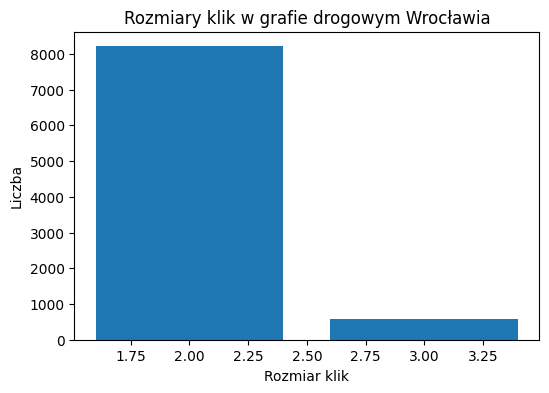

In [16]:
cliques = list(nx.find_cliques(G.to_undirected()))
sizes = [len(c) for c in cliques]
clique_sizes = Counter(sizes)

# Barplot
plt.figure(figsize=(6, 4))
plt.bar(clique_sizes.keys(), clique_sizes.values())
plt.xlabel("Rozmiar klik")
plt.ylabel("Liczba")
plt.title("Rozmiary klik w grafie drogowym Wrocławia")
plt.show()

Oś X (Rozmiar klik): rozmiar kliki, czyli liczba wierzchołków w pełnym podgrafie (każdy z każdym połączony).

### Co to mówi o strukturze sieci drogowej?
- Drogi są z natury rzadkie i rozgałęzione, nie tworzą gęstych, zamkniętych cykli.

- Kliki rozmiaru 3 to rzadkość – mogą wskazywać np. mini-ronda, trójkątne skrzyżowania, albo obszary z bardzo gęstą zabudową (np. stare miasto).

- Brak większych klik (4+) mówi nam, że sieć nie ma gęstych klastrów typu "każdy z każdym" – czyli nie jest "społeczna" w klasycznym sensie.

In [17]:
# 1. Znajdź kliki
cliques = list(nx.find_cliques(G.to_undirected()))

# 2. Filtruj tylko te o rozmiarze 3
cliques_3 = [c for c in cliques if len(c) == 3]

print(f"Znaleziono {len(cliques_3)} klik rozmiaru 3")

# 3. Weź pierwsze kilka do wizualizacji
#cliques_to_plot = cliques_3[:100]
cliques_to_plot = cliques_3


Znaleziono 590 klik rozmiaru 3


In [18]:
# Środek mapy
center_lat = sum(nx.get_node_attributes(G, 'y').values()) / len(G.nodes)
center_lon = sum(nx.get_node_attributes(G, 'x').values()) / len(G.nodes)
m = folium.Map(location=[center_lat, center_lon], zoom_start=13, tiles='cartodbpositron')

# Kolory klik
colors = ['red', 'blue', 'green', 'purple', 'orange']

for i, clique in enumerate(cliques_to_plot):
    color = colors[i % len(colors)]
    for node in clique:
        y = G.nodes[node]['y']
        x = G.nodes[node]['x']
        folium.CircleMarker(
            location=[y, x],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.9,
            popup=f'Klik {i+1} - węzeł {node}'
        ).add_to(m)

    # Połącz punkty liniami
    coords = [(G.nodes[n]['y'], G.nodes[n]['x']) for n in clique]
    coords.append(coords[0])  # zamknięcie trójkąta
    folium.PolyLine(coords, color=color, weight=2, opacity=0.7).add_to(m)

# Zapisz mapę
m.save('community_plots/kliki_wroclaw.html')
print("Mapa klik zapisana jako: kliki_wroclaw.html")

Mapa klik zapisana jako: kliki_wroclaw.html


## Hierarchical clustering using Girvan–Newman algorithm

In [26]:
center = ox.geocode("Wrocław, Rynek")
G_center = ox.graph_from_point(center, dist=1500, network_type='drive')
G_center_undirected = G_center.to_undirected()

Poziom 1 | Liczba społeczności: 2 | Modularność = 0.4852
Poziom 2 | Liczba społeczności: 3 | Modularność = 0.6148
Poziom 3 | Liczba społeczności: 4 | Modularność = 0.7178
Poziom 4 | Liczba społeczności: 5 | Modularność = 0.7498
Poziom 5 | Liczba społeczności: 6 | Modularność = 0.7690
Poziom 6 | Liczba społeczności: 7 | Modularność = 0.7880
Poziom 7 | Liczba społeczności: 8 | Modularność = 0.8125
Poziom 8 | Liczba społeczności: 9 | Modularność = 0.8284
Poziom 9 | Liczba społeczności: 10 | Modularność = 0.8421
Poziom 10 | Liczba społeczności: 11 | Modularność = 0.8454
Poziom 11 | Liczba społeczności: 12 | Modularność = 0.8500
Poziom 12 | Liczba społeczności: 13 | Modularność = 0.8538
Poziom 13 | Liczba społeczności: 14 | Modularność = 0.8558
Poziom 14 | Liczba społeczności: 15 | Modularność = 0.8608
Poziom 15 | Liczba społeczności: 16 | Modularność = 0.8607
Poziom 16 | Liczba społeczności: 17 | Modularność = 0.8620
Poziom 17 | Liczba społeczności: 18 | Modularność = 0.8617
Poziom 18 | Li

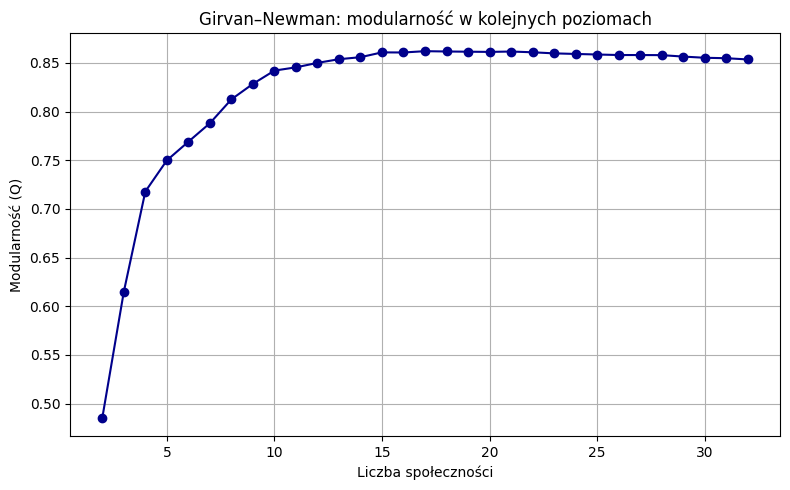

In [27]:
def best_gn_partition(G, max_levels=5):
    best_modularity = -1
    best_partition = None
    modularity_scores = []
    num_communities = []

    for i, partition in enumerate(girvan_newman(G)):
        partition_list = list(partition)
        mod = modularity(G, partition)
        modularity_scores.append(mod)
        num_communities.append(len(partition_list))

        print(f"Poziom {i + 1} | Liczba społeczności: {len(partition_list)} | Modularność = {mod:.4f}")

        if mod > best_modularity:
            best_modularity = mod
            best_partition = partition
        if i >= max_levels:
            break

    plt.figure(figsize=(8, 5))
    plt.plot(num_communities, modularity_scores, marker='o', color='darkblue')
    plt.xlabel("Liczba społeczności")
    plt.ylabel("Modularność (Q)")
    plt.title("Girvan–Newman: modularność w kolejnych poziomach")
    plt.grid(True)
    plt.tight_layout()
    plt.show()    
    return best_partition, best_modularity

partition, mod = best_gn_partition(G_center_undirected, max_levels=30)


In [28]:
# 1. Przypisanie kolorów do społeczności
node_to_comm = {}
for idx, comm in enumerate(partition):
    for node in comm:
        node_to_comm[node] = idx

def random_color():
    return "#"+''.join(random.choices("0123456789ABCDEF", k=6))

community_colors = {i: random_color() for i in range(len(partition))}

# 2. Środek mapy
lats = [G_center.nodes[n]['y'] for n in G_center.nodes()]
lons = [G_center.nodes[n]['x'] for n in G_center.nodes()]
center_lat = sum(lats)/len(lats)
center_lon = sum(lons)/len(lons)

# 3. Tworzenie mapy
m = folium.Map(location=[center_lat, center_lon], zoom_start=14, tiles="cartodbpositron")

# 4. Rysowanie węzłów
for node in G_center.nodes():
    comm = node_to_comm.get(node)
    if comm is not None:
        folium.CircleMarker(
            location=[G_center.nodes[node]['y'], G_center.nodes[node]['x']],
            radius=3,
            color=community_colors[comm],
            fill=True,
            fill_color=community_colors[comm],
            fill_opacity=0.85,
            popup=f"Społeczność: {comm}"
        ).add_to(m)

# 5. (Opcjonalnie) krawędzie
for u, v, data in G_center.edges(data=True):
    if 'geometry' in data:
        line = [(lat, lon) for lon, lat in data['geometry'].coords]
    else:
        line = [
            (G_center.nodes[u]['y'], G_center.nodes[u]['x']),
            (G_center.nodes[v]['y'], G_center.nodes[v]['x'])
        ]
    folium.PolyLine(line, color="#bbbbbb", weight=1, opacity=0.3).add_to(m)

# 6. Zapis mapy
m.save("community_plots/wroclaw_gn_communities.html")
print("Mapa zapisana jako: wroclaw_gn_communities.html")

Mapa zapisana jako: wroclaw_gn_communities.html
